In [ ]:
#pip install leidenalg

In [ ]:
import scanpy as sc
import pandas as pd
import random
import numpy as np
import matplotlib as plt
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats
import gc 
import ctypes
import scvi

In [100]:
gc.collect()
libc = ctypes.CDLL("libc.so.6") # clearing cache 
libc.malloc_trim(0)

1

In [6]:
adata = sc.read_h5ad('/home/sharedFolder/int_fresh_start/descartes_ebru/Macs_from_LuCa_subset.h5ad')

In [8]:
adata.obs

,sample,uicc_stage,ever_smoker,age,donor_id,origin,dataset,ann_fine,cell_type_predicted,doublet_status,...,tissue_type,cell_type,assay,disease,organism,sex,tissue,self_reported_ethnicity,development_stage,observation_joinid
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,tissue,alveolar macrophage,10x 3' v2,normal,Homo sapiens,male,lung,unknown,22-year-old human stage,mr6dH!~~)J
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,tissue,macrophage,10x 3' v2,normal,Homo sapiens,male,lung,unknown,22-year-old human stage,dICnrm?v}Y
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,tissue,alveolar macrophage,10x 3' v2,normal,Homo sapiens,male,lung,unknown,22-year-old human stage,H1`a3qW86-
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,tissue,macrophage,10x 3' v2,normal,Homo sapiens,male,lung,unknown,22-year-old human stage,qs?@SPTAA8
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,tissue,alveolar macrophage,10x 3' v2,normal,Homo sapiens,male,lung,unknown,22-year-old human stage,{$G;K{D61M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,tissue,macrophage,10x 3' v2,lung adenocarcinoma,Homo sapiens,female,lung,unknown,64-year-old human stage,zj+j~6!?SG
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,tissue,macrophage,10x 3' v2,lung adenocarcinoma,Homo sapiens,female,lung,unknown,64-year-old human stage,aqulW)$m4r
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,tissue,macrophage,10x 3' v2,lung adenocarcinoma,Homo sapiens,female,lung,unknown,64-year-old human stage,ZM4j<bhC6A
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,tissue,macrophage,10x 3' v2,lung adenocarcinoma,Homo sapiens,female,lung,unknown,64-year-old human stage,A#pCiVqT8Z


In [9]:
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1.0)

In [101]:
adata.obs.groupby("ann_fine").size()

NameError: name 'adata' is not defined

In [10]:
sc.tl.leiden(adata, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)

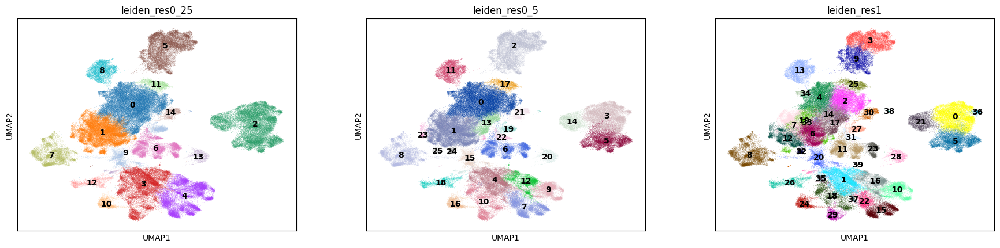

In [11]:
sc.pl.umap(
    adata,
    color=["leiden_res0_25", "leiden_res0_5", "leiden_res1"],
    legend_loc="on data",
)

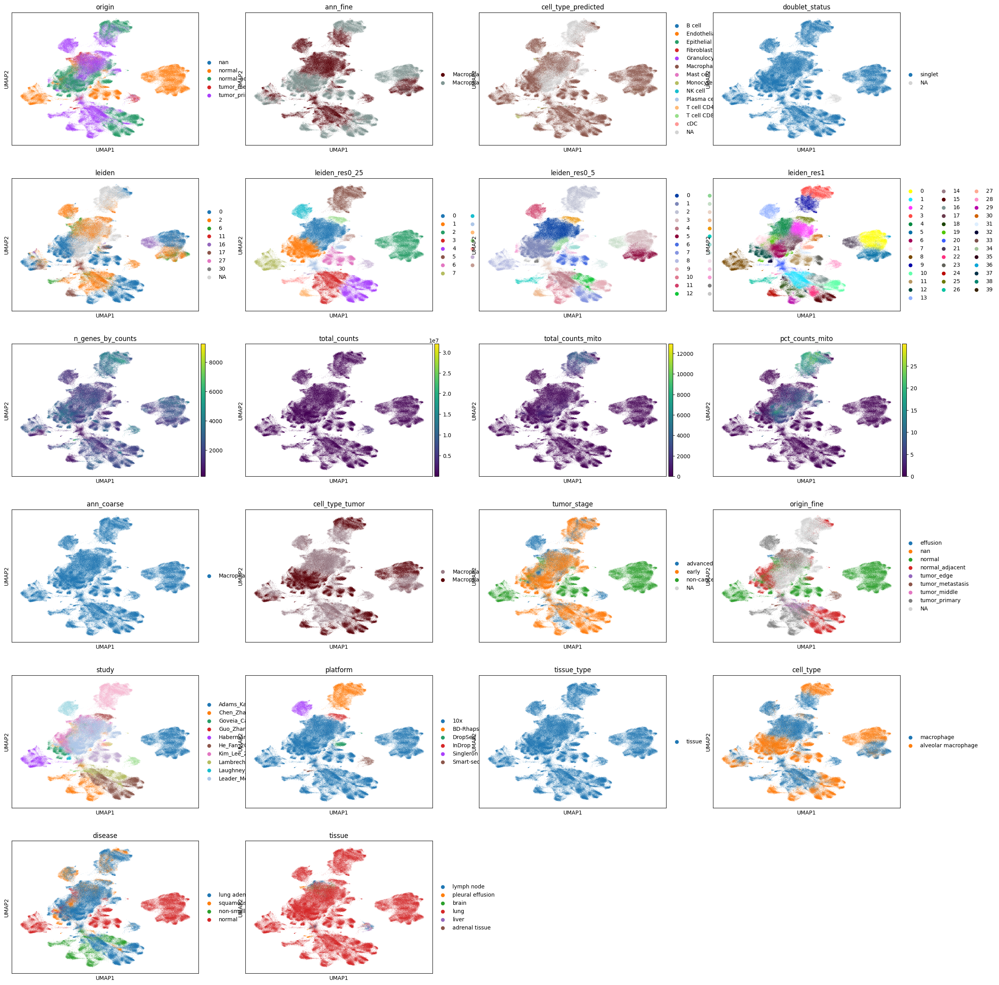

In [12]:
sc.pl.umap(
    adata,
    color=['origin',
 'ann_fine',
 'cell_type_predicted',
 'doublet_status',
 'leiden', "leiden_res0_25", "leiden_res0_5", "leiden_res1",
 'n_genes_by_counts',
 'total_counts',
 'total_counts_mito',
 'pct_counts_mito',
 'ann_coarse',
 'cell_type_tumor',
 'tumor_stage',
 'origin_fine',
 'study',
 'platform',
 'tissue_type',
 'cell_type',
 'disease',
 'tissue'])

### Correct Batches

In [13]:
batch_key = "sample"
label_key = "cell_type"

In [14]:
adata.X

<240130x17797 sparse matrix of type '<class 'numpy.float32'>'
	with 468115836 stored elements in Compressed Sparse Row format>

In [15]:
adata

AnnData object with n_obs × n_vars = 240130 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid', 'leiden_res1', 'leide

In [16]:
scvi.model.SCVI.setup_anndata(adata, layer="count", batch_key=batch_key)
adata

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/data/fields/_dataframe_field.py:186: UserWarning: Category 46 in adata.obs['_scvi_batch'] has fewer than 3 cells. Models may not train properly.
  categorical_mapping = _make_column_categorical(


AnnData object with n_obs × n_vars = 240130 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid', 'leiden_res1', 'leide

In [17]:
X = adata.X
X = np.log1p(X)
X = np.expm1(X)
mean = X.mean(axis=0).A1
mean[mean == 0] = 1e-12
mean = np.log1p(mean)
np.any(mean == np.inf)

False

In [18]:
model_scvi = scvi.model.SCVI(adata)
model_scvi

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

In [19]:
model_scvi.view_anndata_setup()


Anndata setup with scvi-tools version 1.1.5.

Setup via `SCVI.setup_anndata` with arguments:

{
│   'layer': 'count',
│   'batch_key': 'sample',
│   'labels_key': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics          
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓
┃     Summary Stat Key     ┃ Value  ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩
│         n_batch          │  469   │
│         n_cells          │ 240130 │
│ n_extra_categorical_covs │   0    │
│ n_extra_continuous_covs  │   0    │
│         n_labels         │   1    │
│          n_vars          │ 17797  │
└──────────────────────────┴────────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │   adata.layers['count']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                                      batch State Registry                                      
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃                    Categories                    ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │             Adams_Kaminski_2020_001C             │          0          │
│                     │             Adams_Kaminski_2020_002C             │          1          │
│                     │             Adams_Kaminski_2020_003C             │          2          │
│                     │            Adams_Kaminski_2020_022C-a            │          3          │
│                     │            Adams_Kaminski_2020_022C-b            │          4          │
│                     │             Adams_Kaminski_2020_034C             │          5          │
│                     │             Adams_Kaminski_2020_065C             │          6          │
│                     │             Adams_Kaminski_2020_081C             │          7          │
│                     │             Adams_Kaminski_2020_084C             │          8          │
│                     │             Adams_Kaminski_2020_092C             │          9          │
│                     │             Adams_Kaminski_2020_92C              │         10          │
│                     │            Adams_Kaminski_2020_098C-a            │         11          │
│                     │            Adams_Kaminski_2020_098C-b            │         12          │
│                     │            Adams_Kaminski_2020_133C-a            │         13          │
│                     │             Adams_Kaminski_2020_137C             │         14          │
│                     │            Adams_Kaminski_2020_137C-a            │         15          │
│                     │            Adams_Kaminski_2020_137C-b            │         16          │
│                     │             Adams_Kaminski_2020_160C             │         17          │
│                     │            Adams_Kaminski_2020_192C-a            │         18          │
│                     │             Adams_Kaminski_2020_208C             │         19          │
│                     │            Adams_Kaminski_2020_218C-a            │         20          │
│                     │            Adams_Kaminski_2020_218C-b            │         21          │
│                     │            Adams_Kaminski_2020_219C-a            │         22          │
│                     │            Adams_Kaminski_2020_219C-b            │         23          │
│                     │             Adams_Kaminski_2020_222C             │         24          │
│                     │            Adams_Kaminski_2020_226C-a            │         25          │
│                     │            Adams_Kaminski_2020_226C-b            │         26          │
│                     │             Adams_Kaminski_2020_244C             │         27          │
│                     │             Adams_Kaminski_2020_253C             │         28          │
│                     │             Adams_Kaminski_2020_296C             │         29          │
│                     │             Adams_Kaminski_2020_388C             │         30          │
│                     │             Adams_Kaminski_2020_396C             │         31          │
│                     │             Adams_Kaminski_2020_439C             │         32          │
│                     │            Adams_Kaminski_2020_439C-b            │         33          │
│                     │             Adams_Kaminski_2020_454C             │         34          │
│                     │             Adams_Kaminski_2020_465C             │         35          │
│                     │             Adams_Kaminski_2020_483C             │         36          │
│                     │

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [20]:
max_epochs_scvi = np.min([round((20000 / adata.n_obs) * 400), 400])
max_epochs_scvi

33

In [21]:
model_scvi.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=111` in the `DataLoader` to improve performance.


Epoch 1/33:   0%|                                        | 0/33 [00:00<?, ?it/s]

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 2/33:   3%| | 1/33 [01:08<36:31, 68.48s/it, v_num=1, train_loss_step=6.15e

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 3/33:   6%| | 2/33 [02:12<34:05, 65.97s/it, v_num=1, train_loss_step=5.32e

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 4/33:   9%| | 3/33 [03:16<32:32, 65.08s/it, v_num=1, train_loss_step=6.6e+

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 5/33:  12%| | 4/33 [04:19<30:59, 64.10s/it, v_num=1, train_loss_step=5e+3,

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 6/33:  15%|▏| 5/33 [05:20<29:22, 62.96s/it, v_num=1, train_loss_step=6.25e

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 7/33:  18%|▏| 6/33 [06:22<28:12, 62.70s/it, v_num=1, train_loss_step=6.06e

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 8/33:  21%|▏| 7/33 [07:25<27:16, 62.94s/it, v_num=1, train_loss_step=6.04e

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 9/33:  24%|▏| 8/33 [08:30<26:27, 63.51s/it, v_num=1, train_loss_step=6.07e

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 10/33:  27%|▎| 9/33 [09:38<25:54, 64.75s/it, v_num=1, train_loss_step=6.24

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 11/33:  30%|▎| 10/33 [10:44<25:04, 65.41s/it, v_num=1, train_loss_step=6.1

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 12/33:  33%|▎| 11/33 [11:47<23:42, 64.66s/it, v_num=1, train_loss_step=6.6

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 13/33:  36%|▎| 12/33 [12:50<22:22, 63.92s/it, v_num=1, train_loss_step=5.9

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 14/33:  39%|▍| 13/33 [13:52<21:06, 63.35s/it, v_num=1, train_loss_step=6.1

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 15/33:  42%|▍| 14/33 [14:53<19:53, 62.82s/it, v_num=1, train_loss_step=5.2

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 16/33:  45%|▍| 15/33 [15:56<18:47, 62.66s/it, v_num=1, train_loss_step=5.6

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 17/33:  48%|▍| 16/33 [17:00<17:53, 63.13s/it, v_num=1, train_loss_step=5.5

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 18/33:  52%|▌| 17/33 [18:07<17:10, 64.44s/it, v_num=1, train_loss_step=5.7

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 19/33:  55%|▌| 18/33 [19:15<16:21, 65.44s/it, v_num=1, train_loss_step=5.3

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 20/33:  58%|▌| 19/33 [20:22<15:22, 65.90s/it, v_num=1, train_loss_step=6.7

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 21/33:  61%|▌| 20/33 [21:28<14:15, 65.79s/it, v_num=1, train_loss_step=6.5

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 22/33:  64%|▋| 21/33 [22:34<13:10, 65.88s/it, v_num=1, train_loss_step=5.2

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 23/33:  67%|▋| 22/33 [23:37<11:55, 65.06s/it, v_num=1, train_loss_step=5.7

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 24/33:  70%|▋| 23/33 [24:40<10:44, 64.43s/it, v_num=1, train_loss_step=5.1

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 25/33:  73%|▋| 24/33 [25:44<09:40, 64.49s/it, v_num=1, train_loss_step=5.5

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 26/33:  76%|▊| 25/33 [26:49<08:36, 64.51s/it, v_num=1, train_loss_step=5.3

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 27/33:  79%|▊| 26/33 [27:54<07:33, 64.74s/it, v_num=1, train_loss_step=6e+

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 28/33:  82%|▊| 27/33 [28:59<06:29, 64.90s/it, v_num=1, train_loss_step=5.5

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 29/33:  85%|▊| 28/33 [30:05<05:25, 65.02s/it, v_num=1, train_loss_step=4.8

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 30/33:  88%|▉| 29/33 [31:08<04:18, 64.54s/it, v_num=1, train_loss_step=5.9

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 31/33:  91%|▉| 30/33 [32:10<03:11, 63.84s/it, v_num=1, train_loss_step=6.7

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 32/33:  94%|▉| 31/33 [33:14<02:07, 63.83s/it, v_num=1, train_loss_step=6.1

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/33:  97%|▉| 32/33 [34:16<01:03, 63.24s/it, v_num=1, train_loss_step=6.7

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scvi/module/_vae.py:460: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/33: 100%|█| 33/33 [35:19<00:00, 63.06s/it, v_num=1, train_loss_step=5.4

`Trainer.fit` stopped: `max_epochs=33` reached.


Epoch 33/33: 100%|█| 33/33 [35:19<00:00, 64.22s/it, v_num=1, train_loss_step=5.4


In [ ]:
#early_stopping=True

In [22]:
adata.obsm["X_scVI"] = model_scvi.get_latent_representation()

In [23]:
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata)
adata

AnnData object with n_obs × n_vars = 240130 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid', 'leiden_res1', 'leide

In [24]:
sc.tl.leiden(adata, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1.0)

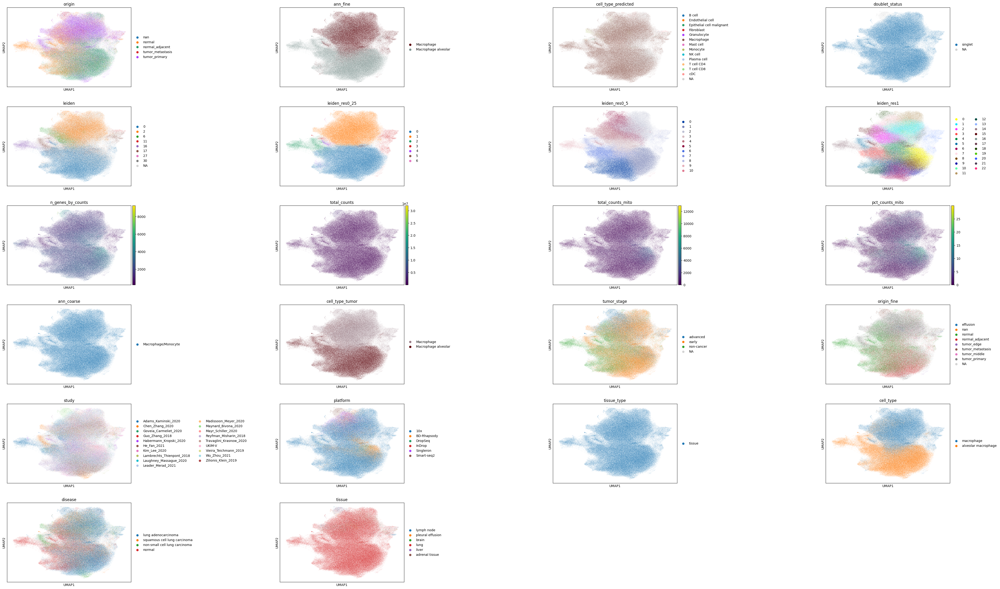

In [25]:
sc.pl.umap(adata, color=['origin',
 'ann_fine',
 'cell_type_predicted',
 'doublet_status',
 'leiden', "leiden_res0_25", "leiden_res0_5", "leiden_res1",
 'n_genes_by_counts',
 'total_counts',
 'total_counts_mito',
 'pct_counts_mito',
 'ann_coarse',
 'cell_type_tumor',
 'tumor_stage',
 'origin_fine',
 'study',
 'platform',
 'tissue_type',
 'cell_type',
 'disease',
 'tissue'], wspace=1)

In [26]:
adata.obs['study'].value_counts()

study
Leader_Merad_2021            43861
Adams_Kaminski_2020          35502
He_Fan_2021                  29972
Kim_Lee_2020                 22974
UKIM-V                       22831
Chen_Zhang_2020              16059
Reyfman_Misharin_2018        12724
Lambrechts_Thienpont_2018    11798
Habermann_Kropski_2020       10968
Goveia_Carmeliet_2020         9419
Wu_Zhou_2021                  7673
Madissoon_Meyer_2020          4111
Zilionis_Klein_2019           3493
Laughney_Massague_2020        3208
Maynard_Bivona_2020           2755
Mayr_Schiller_2020            1622
Vieira_Teichmann_2019         1114
Travaglini_Krasnow_2020         41
Guo_Zhang_2018                   5
Name: count, dtype: int64

In [27]:
adata.write("Macs_from_LuCa_subset_reclustered.h5ad")

In [5]:
adata = sc.read_h5ad('/home/sharedFolder/int_fresh_start/descartes_ebru/Macs_from_LuCa_subset_reclustered.h5ad')

In [6]:
adata.obs['cell_type_predicted'].value_counts()

cell_type_predicted
Macrophage                   172563
Monocyte                       2272
cDC                            1613
Epithelial cell malignant       159
T cell CD4                      114
B cell                           97
T cell CD8                       58
Plasma cell                      29
Fibroblast                       21
Granulocyte                      12
Endothelial cell                  9
Mast cell                         7
NK cell                           6
Name: count, dtype: int64

## AUCell

In [2]:
#AUCell functions
import pandas as pd
import pyscenic 
from pyscenic.aucell import aucell
from arboreto.utils import load_tf_names
from arboreto.algo import grnboost2
from pyscenic.aucell import aucell
from ctxcore.genesig import GeneSignature
from pyscenic.aucell import create_rankings, enrichment, derive_auc_threshold

In [6]:
print(pyscenic.__version__)
print(pyscenic.aucell.__version__)

0.12.1


AttributeError: module 'pyscenic.aucell' has no attribute '__version__'

In [ ]:
#pip install pyscenic

In [8]:
import csv

In [30]:
anti_inf_sign = {
    'SEPP1' : 'Anti-Inf',
    'SLC40A1' : 'Anti-Inf', 
    'FOLR2' : 'Anti-Inf', 
    'MRC1' : 'Anti-Inf', 
    'CD209' : 'Anti-Inf', 
    'RNASE1' : 'Anti-Inf', 
    'SPP1' : 'Anti-Inf', 
    'C1QB' : 'Anti-Inf', 
    'LPL' : 'Anti-Inf', 
    'MS4A4A' : 'Anti-Inf', 
    'VSIG4' : 'Anti-Inf', 
    'SDSL' : 'Anti-Inf', 
    'CCL13' : 'Anti-Inf', 
    'MARCO' : 'Anti-Inf'
}

pro_inf_sign = {
    'STAT1' : 'Pro-Inf',
    'CXCL10' : 'Pro-Inf',
    'CXCL9' : 'Pro-Inf',
    'RSAD2' : 'Pro-Inf',
    'ISG15' : 'Pro-Inf',
    'IFIT2' : 'Pro-Inf',
    'CHIT1' : 'Pro-Inf',
    'CMKLR1' : 'Pro-Inf',
    'GAL3ST4' : 'Pro-Inf',
    'RAB42' : 'Pro-Inf',
    'CCL2' : 'Pro-Inf',
    'CCL3' : 'Pro-Inf'
}

hypo_sign = {
    'BNIP3' : 'Hypoxic',
    'ADAM8' : 'Hypoxic',
    'FAM162A' : 'Hypoxic',
    'MIF' : 'Hypoxic',
    'HILPDA' : 'Hypoxic',
    'ADM' : 'Hypoxic'
}

phag_sign = {
    'FABP5' : 'Phagocytotic',
    'GPNMB' : 'Phagocytotic',
    'LGALS3' : 'Phagocytotic',
    'CD63' : 'Phagocytotic',
    'CD9' : 'Phagocytotic',
    'PLA2G7' : 'Phagocytotic'
}

##### YK edits

In [30]:
marker_genes_dict = {
    "Anti_inflamatory_TAMs": [    'SLC40A1', 
    'FOLR2', 
    'MRC1', 
    'CD209', 
    'RNASE1', 
    'SPP1', 
    'C1QB', 
    'LPL', 
    'MS4A4A', 
    'VSIG4', 
    'SDSL', 
    'CCL13', 
    'MARCO'],
    "Pro_inflamatory_TAMs": ["STAT1", "CXCL10", "CXCL9", "RSAD2", "ISG15", "IFIT2", "CHIT1", "CMKLR1", "GAL3ST4","RAB42", "CCL2", "CCL3"],
    "Hypoxic_TAMs": ["BNIP3", "ADAM8", "FAM162A", "MIF", "HILPDA", "ADM"],
    "Phagocytic_Lipid_TAMs": ["FABP5", "GPNMB", "LGALS3", "CD63", "CD9", "PLA2G7"]
}

In [51]:
type(marker_genes_dict)

dict

### Signature genes for macrophage subtypes
### https://www.cell.com/trends/immunology/fulltext/S1471-4906(22)00094-1 

In [68]:
signatures = GeneSignature.from_gmt("TAMsignatures.gmt", field_separator='\t', gene_separator='\t')
len(signatures)

11

In [60]:
signatures

[GeneSignature(name='Anti_inflamatory_TAMs', gene2weight=frozendict.frozendict({'SEPP1': 1.0, 'SLC40A1': 1.0, 'FOLR2': 1.0, 'MRC1': 1.0, 'CD209': 1.0, 'RNASE1': 1.0, 'SPP1': 1.0, 'C1QB': 1.0, 'LPL': 1.0, 'MS4A4A': 1.0, 'VSIG4': 1.0, 'SDSL': 1.0, 'CCL13': 1.0, 'MARCO': 1.0})),
 GeneSignature(name='Pro_inflamatory_TAMs', gene2weight=frozendict.frozendict({'STAT1': 1.0, 'CXCL10': 1.0, 'CXCL9': 1.0, 'RSAD2': 1.0, 'ISG15': 1.0, 'IFIT2': 1.0, 'CHIT1': 1.0, 'CMKLR1': 1.0, 'GAL3ST4': 1.0, 'RAB42': 1.0, 'CCL2': 1.0, 'CCL3': 1.0})),
 GeneSignature(name='Hypoxic_TAMs', gene2weight=frozendict.frozendict({'BNIP3': 1.0, 'ADAM8': 1.0, 'FAM162A': 1.0, 'MIF': 1.0, 'HILPDA': 1.0, 'ADM': 1.0})),
 GeneSignature(name='Phagocytic_Lipid_TAMs', gene2weight=frozendict.frozendict({'FABP5': 1.0, 'GPNMB': 1.0, 'LGALS3': 1.0, 'CD63': 1.0, 'CD9': 1.0, 'PLA2G7': 1.0})),
 GeneSignature(name='IFN_TAMs', gene2weight=frozendict.frozendict({'CASP1': 1.0, 'CASP4': 1.0, 'CCL2': 1.0, 'CCL3': 1.0, 'CCL4': 1.0, 'CCL7': 1.0, '

In [11]:
adata.var
adata.var['feature_name']

ENSG00000121410        A1BG
ENSG00000268895    A1BG-AS1
ENSG00000175899         A2M
ENSG00000245105     A2M-AS1
ENSG00000166535       A2ML1
                     ...   
ENSG00000070476        ZXDC
ENSG00000203995      ZYG11A
ENSG00000162378      ZYG11B
ENSG00000159840         ZYX
ENSG00000074755       ZZEF1
Name: feature_name, Length: 17797, dtype: category
Categories (17797, object): ['A1BG', 'A1BG-AS1', 'A2M', 'A2M-AS1', ..., 'ZYG11A', 'ZYG11B', 'ZYX', 'ZZEF1']

In [12]:
adata.layers
adata.layers['count']

<240130x17797 sparse matrix of type '<class 'numpy.float32'>'
	with 468532433 stored elements in Compressed Sparse Row format>

In [13]:
sparse_mtx = pd.DataFrame.sparse.from_spmatrix(adata.layers["count"], index=adata.obs_names, columns=adata.var['feature_name'])

In [14]:
sparse_mtx

feature_name,A1BG,A1BG-AS1,A2M,A2M-AS1,A2ML1,A4GALT,A4GNT,AAAS,AACS,AADAC,...,ZW10,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11A,ZYG11B,ZYX,ZZEF1
001C_AAACCTGTCAACACCA-0,0,0,0,0,0,1.0,0,0,0,0,...,0,0,0,0,0,3.0,0,0,4.0,0
001C_AAACGGGAGGCTCATT-0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1.0,0,1.0,0
001C_AAACGGGGTATAATGG-0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1.0,0,1.0,0,0
001C_AAACGGGTCACAAACC-0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
001C_AAAGATGAGTGCTGCC-0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1.0,0,2.0,0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1.0,0
TTTGTCAAGGATATAC-1-38-8,0,0,0,0,0,0,0,0,0,0,...,0,1.0,0,0,0,0,0,0,4.0,0
TTTGTCAAGTACGCGA-1-38-8,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TTTGTCACATCTATGG-1-38-8,0,0,2.0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1.0,1.0,0


In [15]:
percentiles = derive_auc_threshold(sparse_mtx)
percentiles

0.01    0.021633
0.05    0.030679
0.10    0.039220
0.50    0.102939
1.00    0.540428
dtype: float64

In [61]:
#Anti-Inf macrophages
anti_inf_aucs_mtx = aucell(sparse_mtx, signatures, auc_threshold=percentiles[1.00], num_workers=38)
anti_inf_aucs_mtx
#sign. data structure might cause this(?)

Regulon,Anti_inflamatory_TAMs,Pro_inflamatory_TAMs,Hypoxic_TAMs,Phagocytic_Lipid_TAMs,IFN_TAMs,Reg_TAMs,Inflam_TAMs,LA_TAMs,Angio_TAMs,RTM_TAMs,Prolif_TAMs
Cell,,,,,,,,,,,
001C_AAACCTGTCAACACCA-0,0.594286,0.310356,0.314497,0.815086,0.383643,0.533944,0.308520,0.583037,0.433892,0.555335,0.364967
001C_AAACGGGAGGCTCATT-0,0.734104,0.410134,0.029355,0.765232,0.507515,0.386151,0.377544,0.579373,0.551071,0.497579,0.278150
001C_AAACGGGGTATAATGG-0,0.502519,0.396583,0.149321,0.613156,0.420621,0.479085,0.289331,0.468865,0.471209,0.519101,0.262251
001C_AAACGGGTCACAAACC-0,0.613681,0.342301,0.022129,0.918625,0.343250,0.503152,0.267958,0.628695,0.457143,0.437045,0.394659
001C_AAAGATGAGTGCTGCC-0,0.468209,0.362272,0.129670,0.591149,0.372888,0.574821,0.290999,0.525428,0.410846,0.463959,0.291077
...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,0.736928,0.501984,0.290341,0.925071,0.542869,0.559937,0.458438,0.673661,0.525954,0.489744,0.481909
TTTGTCAAGGATATAC-1-38-8,0.773670,0.488139,0.567634,0.820008,0.499064,0.641741,0.531002,0.647044,0.651234,0.581644,0.422489
TTTGTCAAGTACGCGA-1-38-8,0.422061,0.595671,0.041433,0.657621,0.524469,0.460086,0.555955,0.507163,0.513380,0.436031,0.325137


In [62]:
adata.obs = adata.obs.merge(anti_inf_aucs_mtx, left_index=True, right_index=True)

In [64]:
adata.obs

,sample,uicc_stage,ever_smoker,age,donor_id,origin,dataset,ann_fine,cell_type_predicted,doublet_status,...,Pro_inflamatory_TAMs_y,Hypoxic_TAMs_y,Phagocytic_Lipid_TAMs_y,IFN_TAMs,Reg_TAMs,Inflam_TAMs,LA_TAMs,Angio_TAMs,RTM_TAMs,Prolif_TAMs
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.310356,0.314497,0.815086,0.383643,0.533944,0.308520,0.583037,0.433892,0.555335,0.364967
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.410134,0.029355,0.765232,0.507515,0.386151,0.377544,0.579373,0.551071,0.497579,0.278150
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.396583,0.149321,0.613156,0.420621,0.479085,0.289331,0.468865,0.471209,0.519101,0.262251
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.342301,0.022129,0.918625,0.343250,0.503152,0.267958,0.628695,0.457143,0.437045,0.394659
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.362272,0.129670,0.591149,0.372888,0.574821,0.290999,0.525428,0.410846,0.463959,0.291077
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.501984,0.290341,0.925071,0.542869,0.559937,0.458438,0.673661,0.525954,0.489744,0.481909
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.488139,0.567634,0.820008,0.499064,0.641741,0.531002,0.647044,0.651234,0.581644,0.422489
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.595671,0.041433,0.657621,0.524469,0.460086,0.555955,0.507163,0.513380,0.436031,0.325137
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.470385,0.631420,0.968427,0.563514,0.562356,0.549811,0.615895,0.546339,0.490394,0.429672


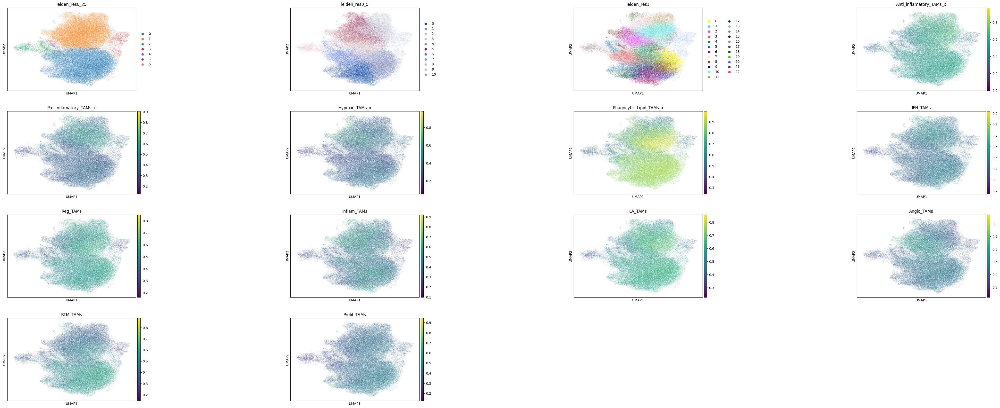

In [66]:

sc.pl.umap(adata, color=[ "leiden_res0_25", "leiden_res0_5", "leiden_res1", 
                         "Anti_inflamatory_TAMs_x", "Pro_inflamatory_TAMs_x", "Hypoxic_TAMs_x", "Phagocytic_Lipid_TAMs_x", 
                        "IFN_TAMs",	"Reg_TAMs",	"Inflam_TAMs",	"LA_TAMs",	"Angio_TAMs",	"RTM_TAMs",	"Prolif_TAMs"], wspace=1)




In [77]:
adata_tp = adata[adata.obs['origin'].isin(['tumor_primary'])]

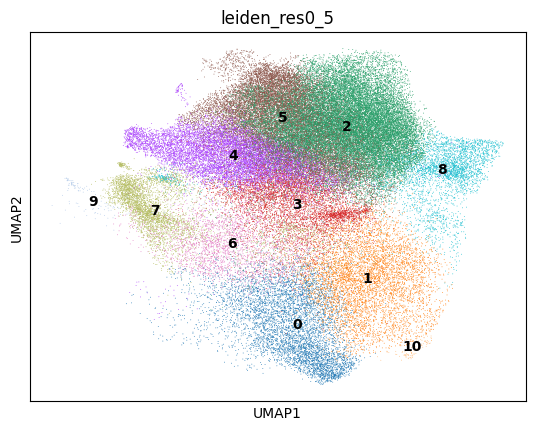

In [82]:

sc.pl.umap(adata_tp, color=[ "leiden_res0_5"], legend_loc="on data", wspace=1)




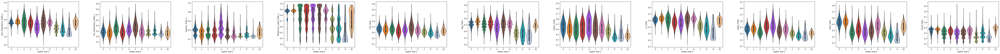

In [83]:
sc.pl.violin(
        adata_tp,
        ["Anti_inflamatory_TAMs_x", "Pro_inflamatory_TAMs_x", "Hypoxic_TAMs_x", "Phagocytic_Lipid_TAMs_x", "IFN_TAMs", "Reg_TAMs",	"Inflam_TAMs",	"LA_TAMs",	"Angio_TAMs",	"RTM_TAMs",	"Prolif_TAMs"],
        groupby="leiden_res0_5",
        stripplot=False,  # remove the internal dots
        inner="box",  # adds a boxplot inside violins
    )

categories: 0, 1, 2, etc.
var_group_labels: Anti_inflamatory_TAMs, Pro_inflamatory_TAMs, Hypoxic_TAMs, etc.


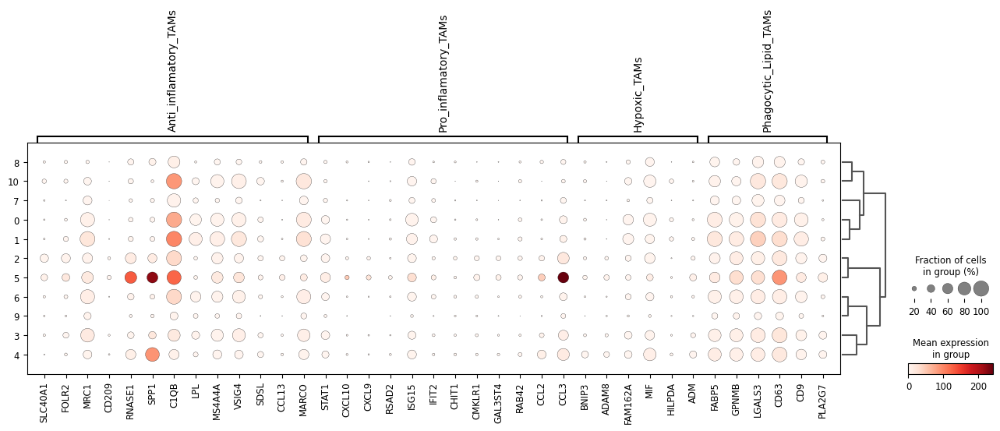

In [85]:
sc.pl.dotplot(adata_tp, marker_genes_dict, "leiden_res0_5", gene_symbols="feature_name", dendrogram=True)

categories: 0, 1, 2, etc.
var_group_labels: Anti_inflamatory_TAMs, Pro_inflamatory_TAMs, Hypoxic_TAMs, etc.


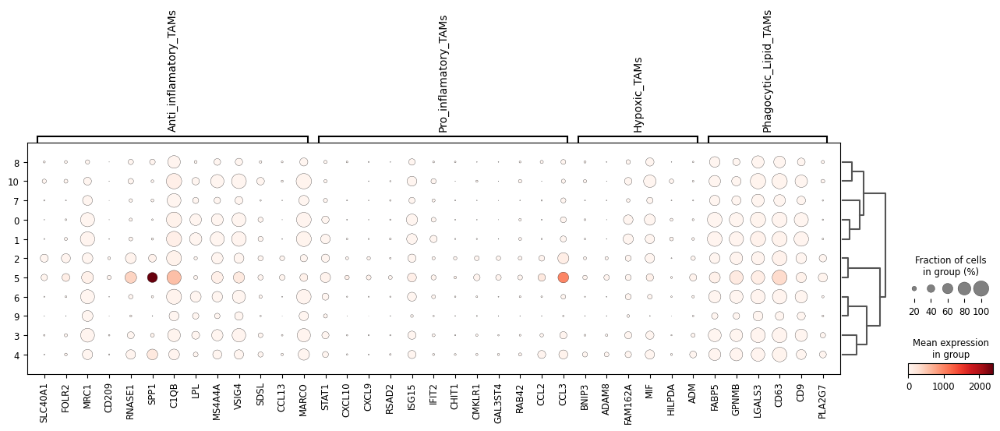

In [32]:
sc.pl.dotplot(adata, marker_genes_dict, "leiden_res0_5", gene_symbols="feature_name", dendrogram=True)

categories: 0, 1, 2, etc.
var_group_labels: Anti_inflamatory_TAMs, Pro_inflamatory_TAMs, Hypoxic_TAMs, etc.


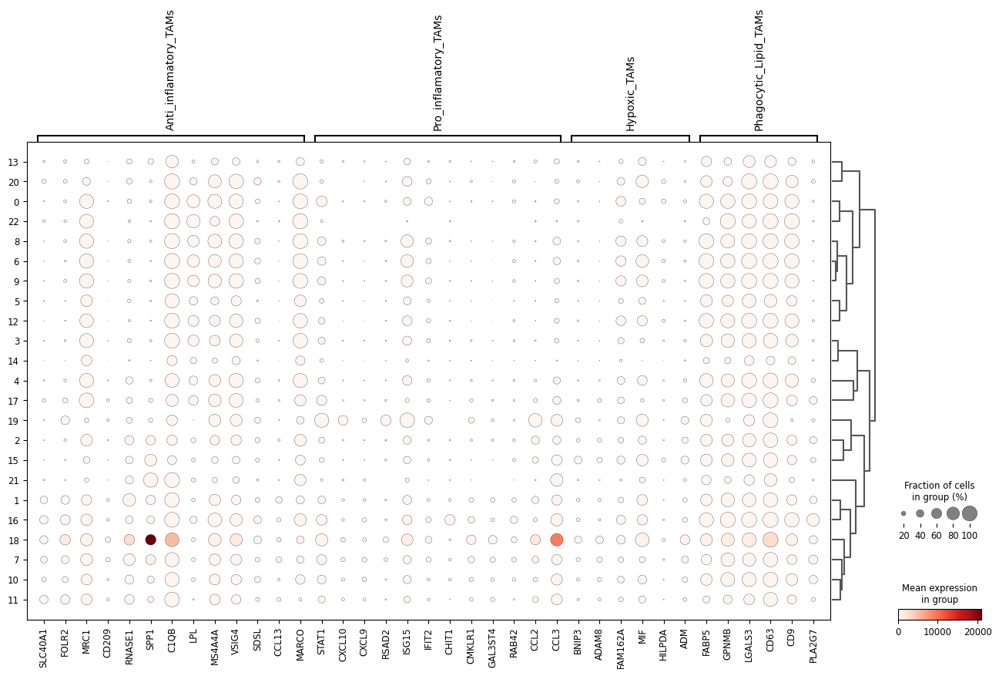

In [33]:
sc.pl.dotplot(adata, marker_genes_dict, "leiden_res1", gene_symbols="feature_name", dendrogram=True)

In [46]:
marker_genes_dict

{'Anti_inflamatory_TAMs': ['SLC40A1',
  'FOLR2',
  'MRC1',
  'CD209',
  'RNASE1',
  'SPP1',
  'C1QB',
  'LPL',
  'MS4A4A',
  'VSIG4',
  'SDSL',
  'CCL13',
  'MARCO'],
 'Pro_inflamatory_TAMs': ['STAT1',
  'CXCL10',
  'CXCL9',
  'RSAD2',
  'ISG15',
  'IFIT2',
  'CHIT1',
  'CMKLR1',
  'GAL3ST4',
  'RAB42',
  'CCL2',
  'CCL3'],
 'Hypoxic_TAMs': ['BNIP3', 'ADAM8', 'FAM162A', 'MIF', 'HILPDA', 'ADM'],
 'Phagocytic_Lipid_TAMs': ['FABP5',
  'GPNMB',
  'LGALS3',
  'CD63',
  'CD9',
  'PLA2G7']}

categories: 0, 1, 2, etc.
var_group_labels: Anti_inflamatory_TAMs, Pro_inflamatory_TAMs, Hypoxic_TAMs, etc.


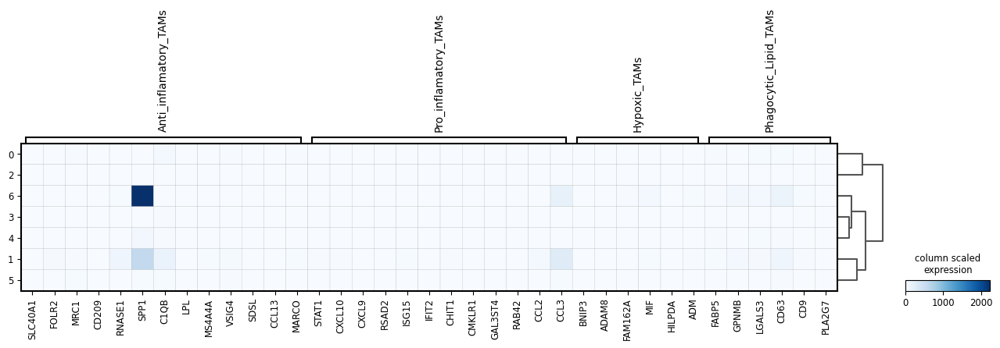

In [37]:
sc.pl.matrixplot(
    adata,
    marker_genes_dict,
    "leiden_res0_25", gene_symbols="feature_name",
    dendrogram=True,
    cmap="Blues",
    standard_scale="obs",
    colorbar_title="column scaled\nexpression",
)

In [63]:
adata.write("Macs_from_LuCa_subset_reclustered_aucell.h5ad")

In [44]:
adata = sc.read_h5ad('/home/sharedFolder/int_fresh_start/descartes_ebru/Macs_from_LuCa_subset_reclustered_aucell.h5ad')

In [53]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)


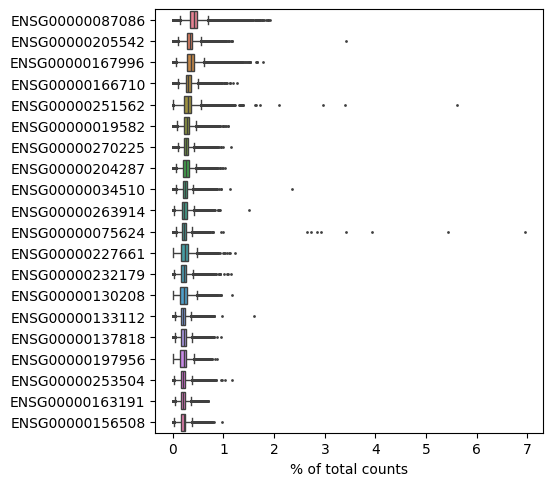

In [54]:
sc.pl.highest_expr_genes(adata, n_top=20)

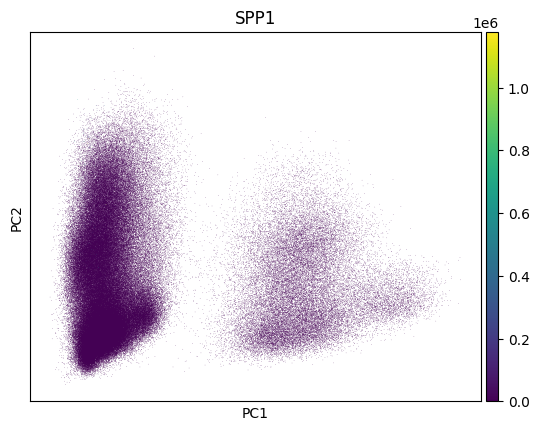

In [56]:
sc.pl.pca(adata, gene_symbols="feature_name", color="SPP1")


In [57]:
adata.obs

,sample,uicc_stage,ever_smoker,age,donor_id,origin,dataset,ann_fine,cell_type_predicted,doublet_status,...,observation_joinid,leiden_res1,leiden_res0_25,leiden_res0_5,_scvi_batch,_scvi_labels,Anti_inflamatory_TAMs,Pro_inflamatory_TAMs,Hypoxic_TAMs,Phagocytic_Lipid_TAMs
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,mr6dH!~~)J,8,0,0,0,0,0.537342,0.256888,0.429992,0.859742
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,dICnrm?v}Y,2,1,4,0,0,0.652487,0.305443,0.213159,0.769859
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,H1`a3qW86-,3,0,6,0,0,0.467441,0.324331,0.305954,0.668296
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,qs?@SPTAA8,4,1,3,0,0,0.559736,0.304005,0.187149,0.929975
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,{$G;K{D61M,3,0,6,0,0,0.420118,0.297480,0.264833,0.648628
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,zj+j~6!?SG,4,0,3,270,0,0.664467,0.430044,0.393221,0.923667
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,aqulW)$m4r,2,1,3,270,0,0.686717,0.408115,0.646358,0.883396
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,ZM4j<bhC6A,2,1,4,270,0,0.308580,0.576878,0.259046,0.748198
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,A#pCiVqT8Z,7,1,5,270,0,0.560743,0.418755,0.727785,0.977715


In [58]:
adata.obs.to_csv("Obsdata.Macs_from_LuCa_subset_reclustered_aucell.csv")

## Quality Control 

In [86]:
adata.obs_keys

<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 240130 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observat

In [107]:
adata.obs.groupby('ann_fine').size()

ann_fine
Macrophage             111777
Macrophage alveolar    128353
dtype: int64

In [106]:
adata_filtered.obs.groupby('ann_fine').size()

ann_fine
Macrophage             86566
Macrophage alveolar    93123
dtype: int64

In [119]:
adata_filtered_new.obs.groupby('ann_fine').size()

ann_fine
Macrophage             73575
Macrophage alveolar    63547
dtype: int64

### 1. Gene Counts (n_genes_by_counts):

* We filter cells that have unique feature counts over 2,500 or less than 200.

In [101]:
min_genes = adata.obs['n_genes_by_counts'].min()
max_genes = adata.obs['n_genes_by_counts'].max()
print(f"Minimum Number of Genes Detected: {min_genes}")
print(f"Maximum Number of Genes Detected: {max_genes}")

Minimum Number of Genes Detected: 210
Maximum Number of Genes Detected: 9257


In [102]:
adata_filtered = adata[(adata.obs['n_genes_by_counts'] > 200) &
                       (adata.obs['n_genes_by_counts'] < 5000), :]

min_genes = adata_filtered.obs['n_genes_by_counts'].min()
max_genes = adata_filtered.obs['n_genes_by_counts'].max()
print(f"Minimum Number of Genes Detected: {min_genes}")
print(f"Maximum Number of Genes Detected: {max_genes}")

Minimum Number of Genes Detected: 210
Maximum Number of Genes Detected: 4999


In [117]:
adata_filtered_new = adata_filtered[(adata_filtered.obs['n_genes_by_counts'] > 200) &
                       (adata_filtered.obs['n_genes_by_counts'] < 2500), :]

min_genes = adata_filtered_new.obs['n_genes_by_counts'].min()
max_genes = adata_filtered_new.obs['n_genes_by_counts'].max()
print(f"Minimum Number of Genes Detected: {min_genes}")
print(f"Maximum Number of Genes Detected: {max_genes}")

Minimum Number of Genes Detected: 240
Maximum Number of Genes Detected: 2499


In [114]:
adata_filtered.obs_keys

<bound method AnnData.obs_keys of View of AnnData object with n_obs × n_vars = 179689 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', '

### 2. Total UMI Count (total_counts):

* Generally, a minimum of 500-1000 UMI counts per cell is expected. Lower counts may indicate poor quality cells.
* The upper limit may vary depending on the dataset and cell type, but generally the total number of UMIs per cell is expected to be between 20,000 and 50,000. Very high UMI numbers could potentially indicate doublet or multiplet cells (where multiple cells are sequenced together).

In [88]:
min_counts = adata.obs['total_counts'].min()
max_counts = adata.obs['total_counts'].max()
print(f"Minimum Number of Counts Detected: {min_counts}")
print(f"Maximum Number of Counts Detected: {max_counts}")

Minimum Number of Counts Detected: 452.0
Maximum Number of Counts Detected: 32008106.0


In [103]:
adata_filtered = adata_filtered[(adata_filtered.obs['total_counts'] > 1000) &
                       (adata_filtered.obs['total_counts'] < 25000), :]

min_counts = adata_filtered.obs['total_counts'].min()
max_counts = adata_filtered.obs['total_counts'].max()
print(f"Minimum Number of Counts Detected: {min_counts}")
print(f"Maximum Number of Counts Detected: {max_counts}")

Minimum Number of Counts Detected: 1001.0
Maximum Number of Counts Detected: 24999.0


### 3. Mitochondrial Gene Percentage (pct_counts_mito):

* The percentage of mRNA from mitochondrial genes should generally not exceed 5-10% per cell. Higher percentages of mitochondrial genes may indicate that cells are stressed or damaged.

In [89]:
min_mito = adata.obs['pct_counts_mito'].min()
max_mito = adata.obs['pct_counts_mito'].max()
print(f"Minimum Number of Mito Percent: {min_mito}")
print(f"Maximum Number of Mito Percent: {max_mito}")

Minimum Number of Mito Percent: 0.0
Maximum Number of Mito Percent: 29.984437942504883


In [104]:
adata_filtered = adata_filtered[adata_filtered.obs['pct_counts_mito'] < 5, :]

min_mito = adata_filtered.obs['pct_counts_mito'].min()
max_mito = adata_filtered.obs['pct_counts_mito'].max()
print(f"Minimum Number of Mito Percent: {min_mito}")
print(f"Maximum Number of Mito Percent: {max_mito}")

Minimum Number of Mito Percent: 0.0
Maximum Number of Mito Percent: 4.999481678009033


In [105]:
adata_filtered.write("Macs_from_LuCa_subset_filtered.h5ad")

In [2]:
adata_filtered = sc.read_h5ad('/home/sharedFolder/int_fresh_start/descartes_ebru/Macs_from_LuCa_subset_filtered.h5ad')

In [3]:
adata_filtered.obs_keys

<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 179689 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observat

In [4]:
adata_filtered.obs['Subtype'] = adata_filtered.obs[[ 'IFN_TAMs',	'Reg_TAMs',	'Inflam_TAMs',	'LA_TAMs',	'Angio_TAMs',	
                                                    'RTM_TAMs',	'Prolif_TAMs']].idxmax(axis=1)

In [5]:
adata_filtered.obs

,sample,uicc_stage,ever_smoker,age,donor_id,origin,dataset,ann_fine,cell_type_predicted,doublet_status,...,Hypoxic_TAMs_y,Phagocytic_Lipid_TAMs_y,IFN_TAMs,Reg_TAMs,Inflam_TAMs,LA_TAMs,Angio_TAMs,RTM_TAMs,Prolif_TAMs,Subtype
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.314497,0.815086,0.383643,0.533944,0.308520,0.583037,0.433892,0.555335,0.364967,LA_TAMs
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.029355,0.765232,0.507515,0.386151,0.377544,0.579373,0.551071,0.497579,0.278150,LA_TAMs
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.149321,0.613156,0.420621,0.479085,0.289331,0.468865,0.471209,0.519101,0.262251,RTM_TAMs
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.022129,0.918625,0.343250,0.503152,0.267958,0.628695,0.457143,0.437045,0.394659,LA_TAMs
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.129670,0.591149,0.372888,0.574821,0.290999,0.525428,0.410846,0.463959,0.291077,Reg_TAMs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.290341,0.925071,0.542869,0.559937,0.458438,0.673661,0.525954,0.489744,0.481909,LA_TAMs
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.567634,0.820008,0.499064,0.641741,0.531002,0.647044,0.651234,0.581644,0.422489,Angio_TAMs
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.041433,0.657621,0.524469,0.460086,0.555955,0.507163,0.513380,0.436031,0.325137,Inflam_TAMs
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.631420,0.968427,0.563514,0.562356,0.549811,0.615895,0.546339,0.490394,0.429672,LA_TAMs


In [6]:
adata_filtered.obs.groupby('Subtype').size()

Subtype
Angio_TAMs      10590
IFN_TAMs         6482
Inflam_TAMs     11491
LA_TAMs        125992
Prolif_TAMs      1681
RTM_TAMs        10763
Reg_TAMs        12690
dtype: int64

In [7]:
subtype = adata_filtered.obs[['IFN_TAMs',	'Reg_TAMs',	'Inflam_TAMs',	'LA_TAMs',	'Angio_TAMs',	
                              'RTM_TAMs',	'Prolif_TAMs', 'Subtype']]
subtype

,IFN_TAMs,Reg_TAMs,Inflam_TAMs,LA_TAMs,Angio_TAMs,RTM_TAMs,Prolif_TAMs,Subtype
001C_AAACCTGTCAACACCA-0,0.383643,0.533944,0.308520,0.583037,0.433892,0.555335,0.364967,LA_TAMs
001C_AAACGGGAGGCTCATT-0,0.507515,0.386151,0.377544,0.579373,0.551071,0.497579,0.278150,LA_TAMs
001C_AAACGGGGTATAATGG-0,0.420621,0.479085,0.289331,0.468865,0.471209,0.519101,0.262251,RTM_TAMs
001C_AAACGGGTCACAAACC-0,0.343250,0.503152,0.267958,0.628695,0.457143,0.437045,0.394659,LA_TAMs
001C_AAAGATGAGTGCTGCC-0,0.372888,0.574821,0.290999,0.525428,0.410846,0.463959,0.291077,Reg_TAMs
...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,0.542869,0.559937,0.458438,0.673661,0.525954,0.489744,0.481909,LA_TAMs
TTTGTCAAGGATATAC-1-38-8,0.499064,0.641741,0.531002,0.647044,0.651234,0.581644,0.422489,Angio_TAMs
TTTGTCAAGTACGCGA-1-38-8,0.524469,0.460086,0.555955,0.507163,0.513380,0.436031,0.325137,Inflam_TAMs
TTTGTCACATCTATGG-1-38-8,0.563514,0.562356,0.549811,0.615895,0.546339,0.490394,0.429672,LA_TAMs


In [47]:
subtype.to_csv('subtype_matrix.csv')

In [43]:
subtypes_list = ['IFN_TAMs',	'Reg_TAMs',	'Inflam_TAMs',	'LA_TAMs',	
                 'Angio_TAMs',	'RTM_TAMs',	'Prolif_TAMs']

In [ ]:
import pandas as pd

def save_barcodes_for_subtypes(adata, subtypes, column_name, top_n, output_dir):
    """
    It filters the data in adata.obs based on each subtype in the given subtype list, sorts it by a specified column, selects the top N rows, and saves the results as CSV files.

    Parameters:
    adata (AnnData): An AnnData object containing cell data.

    subtypes (list): A list of subtype names to filter.

    column_name (str): The name of the column used for sorting.

    top_n (int): The number of top cells to select.

    output_dir (str): The directory path where CSV files will be saved.
    """
    
    for subtype in subtypes:
        # Filter and sort the data for each subtype
        filtered_data = adata.obs[adata.obs['Subtype'] == subtype]
        sorted_data = filtered_data.sort_values(by=column_name, ascending=False)
        top_data = sorted_data.head(top_n)
        
        # Extract the top indices (barcodes)
        barcodes = pd.DataFrame(top_data.index, columns=['Barcodes'])
        
        # Save the barcodes to a CSV file with a unique name for each subtype
        output_file = f"{output_dir}/{subtype}_barcodes.csv"
        barcodes.to_csv(output_file, index=False)
        
        print(f"Top {top_n} barcodes for '{subtype}' saved to {output_file}")

# example usage:
# subtypes_list = ['Pro_inflamatory_TAMs', 'Anti_inflamatory_TAMs', 'Another_Subtype']
# save_barcodes_for_subtypes(adata, subtypes_list, 'Pro_inflamatory_TAMs', 250, 'output')


In [45]:
save_barcodes_for_subtypes(adata_filtered, subtypes_list, 'IFN_TAMs', 250, '/home/sharedFolder/int_fresh_start/descartes_ebru')

Top 250 barcodes for 'IFN_TAMs' saved to /home/sharedFolder/int_fresh_start/descartes_ebru/IFN_TAMs_barcodes.csv
Top 250 barcodes for 'Reg_TAMs' saved to /home/sharedFolder/int_fresh_start/descartes_ebru/Reg_TAMs_barcodes.csv
Top 250 barcodes for 'Inflam_TAMs' saved to /home/sharedFolder/int_fresh_start/descartes_ebru/Inflam_TAMs_barcodes.csv
Top 250 barcodes for 'LA_TAMs' saved to /home/sharedFolder/int_fresh_start/descartes_ebru/LA_TAMs_barcodes.csv
Top 250 barcodes for 'Angio_TAMs' saved to /home/sharedFolder/int_fresh_start/descartes_ebru/Angio_TAMs_barcodes.csv
Top 250 barcodes for 'RTM_TAMs' saved to /home/sharedFolder/int_fresh_start/descartes_ebru/RTM_TAMs_barcodes.csv
Top 250 barcodes for 'Prolif_TAMs' saved to /home/sharedFolder/int_fresh_start/descartes_ebru/Prolif_TAMs_barcodes.csv


In [38]:
list(adata_filtered.obs[adata_filtered.obs['Subtype'] == 'Anti_inflamatory_TAMs_x'].sort_values(by='Anti_inflamatory_TAMs_x', ascending=False).head(250).index)
#pd.DataFrame(anti_inf, columns=['Barcodes'])

['TGATTTCGTTAGATGA_LUNG_T09-5',
 'TACTCGCCAAAGGAAG_LUNG_T09-5',
 'CGTTAGACATCCGTGG_LUNG_T09-5',
 'CGAGAAGTCAACACTG_LUNG_T09-5',
 'TTTGGTTTCTTGTATC-1-16-8',
 'CCACGGATCAAGAAGT-1_11-9',
 'GGTGAAGCAGGTCCAC.9.NEC-2',
 'CGGACACCAAGACGTG_LUNG_T09-5',
 'ACATACGAGACACGAC_LUNG_T09-5',
 'bcHJLO_13-21',
 'CACCTTGGTGTTCTTT-1_1-9',
 'GACACGCTCGGAAACG_LUNG_T08-5',
 'GCCCAGATCGACCCAG-1_4-1',
 '166288044550059_12-10',
 '170137186589493_0-10',
 'CCACTACGTGAGGCTA_BRONCHO_58-5',
 '53_AAGGTCTTAAAT-20',
 'AACGTTGTCCTTTCGG-1_5-6',
 '226C-a_CGGCTAGCAGACGCAA-0',
 'ATTATCCCACCGAAAG-1_6-6',
 '439C-b_CATATGGGTGCAGGTA-0',
 'ACACCGGTCACCTCGT_LUNG_T09-5',
 'bcHQLP_1-21',
 'AAACCTGAGTCGATAA_LUNG_T09-5',
 'TCATCCGAGGTAGTAT-1_4-1',
 'GTCTTCGCAAGTAGTA_LUNG_T09-5',
 'ATAGAGACATCACCAA-1_4-1',
 'ACGAGCCAGATCCCAT_LUNG_T09-5',
 'TACTTCAGTCAATGGG-1_4-1',
 'CAGCGACGTAGTACCT_LUNG_T09-5',
 '627586_3-18',
 'TCAGCAATCAACCAAC-1_5-6',
 'TGTCCCATCGCGTTTC-1_1-15',
 'bcEQYQ_1-21',
 'CTAGAGTTCAAACAAG-1_1-6',
 '54_GATAAATCGCGC-20',
 'TT

# scCODA Analysis

Not: Bu analizi kendi bilgisayarımda yaptım.

In [8]:
projection = pd.read_csv("hierobj_evaluatio.csv", index_col=0)
projection.index

Index(['001C_AAACCTGTCAACACCA-0', '001C_AAACGGGAGGCTCATT-0',
       '001C_AAACGGGGTATAATGG-0', '001C_AAACGGGTCACAAACC-0',
       '001C_AAAGATGAGTGCTGCC-0', '001C_AAAGATGGTTAGATGA-0',
       '001C_AAAGCAAAGCATGGCA-0', '001C_AAAGTAGGTGTTTGTG-0',
       '001C_AAATGCCCATGTCTCC-0', '001C_AAATGCCGTGTGACCC-0',
       ...
       'TTTGCGCCACATCTTT-1-38-8', 'TTTGGTTCAGTGACAG-1-38-8',
       'TTTGGTTTCCATGAAC-1-38-8', 'TTTGTCAAGCCTATGT-1-38-8',
       'TTTGTCAAGCTAAACA-1-38-8', 'TTTGTCAAGCTGTCTA-1-38-8',
       'TTTGTCAAGGATATAC-1-38-8', 'TTTGTCAAGTACGCGA-1-38-8',
       'TTTGTCACATCTATGG-1-38-8', 'TTTGTCAGTGTTGGGA-1-38-8'],
      dtype='object', length=177939)

In [22]:
projection

,Score,Projection
001C_AAACCTGTCAACACCA-0,5.716232,RTM_TAMs
001C_AAACGGGAGGCTCATT-0,4.407838,Angio_TAMs
001C_AAACGGGGTATAATGG-0,4.398083,RTM_TAMs
001C_AAACGGGTCACAAACC-0,2.734440,RTM_TAMs
001C_AAAGATGAGTGCTGCC-0,4.976786,RTM_TAMs
...,...,...
TTTGTCAAGCTGTCTA-1-38-8,2.776226,RTM_TAMs
TTTGTCAAGGATATAC-1-38-8,4.875359,Angio_TAMs
TTTGTCAAGTACGCGA-1-38-8,4.064913,Angio_TAMs
TTTGTCACATCTATGG-1-38-8,6.690722,Reg_TAMs


In [9]:
subset_adata = adata_filtered[adata_filtered.obs_names.isin(projection.index), :]
subset_adata

View of AnnData object with n_obs × n_vars = 177939 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid', 'leiden_res1'

In [16]:
# Hücre türü ve örnek bilgilerini içeren bir DataFrame oluşturma
df = subset_adata.obs[['sample', 'cell_type']]

# Sample ve cell_type bazında hücre sayısını gruplandırma ve sayma
cell_counts = df.groupby(['sample', 'cell_type']).size().reset_index(name='count')

# Sonuçta elde edilen tabloyu pivot formatına getirme (count matrix)
count_matrix = cell_counts.pivot(index='sample', columns='cell_type', values='count').fillna(0)

# Count matrix'e göz atma
print(count_matrix)


,sample,uicc_stage,ever_smoker,age,donor_id,origin,dataset,ann_fine,cell_type_predicted,doublet_status,...,Hypoxic_TAMs_y,Phagocytic_Lipid_TAMs_y,IFN_TAMs,Reg_TAMs,Inflam_TAMs,LA_TAMs,Angio_TAMs,RTM_TAMs,Prolif_TAMs,Subtype
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.314497,0.815086,0.383643,0.533944,0.308520,0.583037,0.433892,0.555335,0.364967,LA_TAMs
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.029355,0.765232,0.507515,0.386151,0.377544,0.579373,0.551071,0.497579,0.278150,LA_TAMs
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.149321,0.613156,0.420621,0.479085,0.289331,0.468865,0.471209,0.519101,0.262251,RTM_TAMs
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.022129,0.918625,0.343250,0.503152,0.267958,0.628695,0.457143,0.437045,0.394659,LA_TAMs
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.129670,0.591149,0.372888,0.574821,0.290999,0.525428,0.410846,0.463959,0.291077,Reg_TAMs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.290341,0.925071,0.542869,0.559937,0.458438,0.673661,0.525954,0.489744,0.481909,LA_TAMs
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.567634,0.820008,0.499064,0.641741,0.531002,0.647044,0.651234,0.581644,0.422489,Angio_TAMs
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.041433,0.657621,0.524469,0.460086,0.555955,0.507163,0.513380,0.436031,0.325137,Inflam_TAMs
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.631420,0.968427,0.563514,0.562356,0.549811,0.615895,0.546339,0.490394,0.429672,LA_TAMs


In [21]:
subset_adata.obs

,sample,uicc_stage,ever_smoker,age,donor_id,origin,dataset,ann_fine,cell_type_predicted,doublet_status,...,Hypoxic_TAMs_y,Phagocytic_Lipid_TAMs_y,IFN_TAMs,Reg_TAMs,Inflam_TAMs,LA_TAMs,Angio_TAMs,RTM_TAMs,Prolif_TAMs,Subtype
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.314497,0.815086,0.383643,0.533944,0.308520,0.583037,0.433892,0.555335,0.364967,LA_TAMs
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.029355,0.765232,0.507515,0.386151,0.377544,0.579373,0.551071,0.497579,0.278150,LA_TAMs
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.149321,0.613156,0.420621,0.479085,0.289331,0.468865,0.471209,0.519101,0.262251,RTM_TAMs
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.022129,0.918625,0.343250,0.503152,0.267958,0.628695,0.457143,0.437045,0.394659,LA_TAMs
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.129670,0.591149,0.372888,0.574821,0.290999,0.525428,0.410846,0.463959,0.291077,Reg_TAMs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.290341,0.925071,0.542869,0.559937,0.458438,0.673661,0.525954,0.489744,0.481909,LA_TAMs
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.567634,0.820008,0.499064,0.641741,0.531002,0.647044,0.651234,0.581644,0.422489,Angio_TAMs
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.041433,0.657621,0.524469,0.460086,0.555955,0.507163,0.513380,0.436031,0.325137,Inflam_TAMs
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.631420,0.968427,0.563514,0.562356,0.549811,0.615895,0.546339,0.490394,0.429672,LA_TAMs


In [23]:
subset_adata.obs["Projection"] = projection["Projection"]

/tmp/ipykernel_206237/2862196115.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  subset_adata.obs["Projection"] = projection["Projection"]


In [25]:
subset_adata.obs

,sample,uicc_stage,ever_smoker,age,donor_id,origin,dataset,ann_fine,cell_type_predicted,doublet_status,...,Phagocytic_Lipid_TAMs_y,IFN_TAMs,Reg_TAMs,Inflam_TAMs,LA_TAMs,Angio_TAMs,RTM_TAMs,Prolif_TAMs,Subtype,Projection
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.815086,0.383643,0.533944,0.308520,0.583037,0.433892,0.555335,0.364967,LA_TAMs,RTM_TAMs
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.765232,0.507515,0.386151,0.377544,0.579373,0.551071,0.497579,0.278150,LA_TAMs,Angio_TAMs
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.613156,0.420621,0.479085,0.289331,0.468865,0.471209,0.519101,0.262251,RTM_TAMs,RTM_TAMs
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage,Macrophage,singlet,...,0.918625,0.343250,0.503152,0.267958,0.628695,0.457143,0.437045,0.394659,LA_TAMs,RTM_TAMs
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer,no,22.0,Adams_Kaminski_2020_001C,normal,Adams_Kaminski_2020,Macrophage alveolar,Macrophage,singlet,...,0.591149,0.372888,0.574821,0.290999,0.525428,0.410846,0.463959,0.291077,Reg_TAMs,RTM_TAMs
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.925071,0.542869,0.559937,0.458438,0.673661,0.525954,0.489744,0.481909,LA_TAMs,RTM_TAMs
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.820008,0.499064,0.641741,0.531002,0.647044,0.651234,0.581644,0.422489,Angio_TAMs,Angio_TAMs
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.657621,0.524469,0.460086,0.555955,0.507163,0.513380,0.436031,0.325137,Inflam_TAMs,Angio_TAMs
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,II,no,64.0,Leader_Merad_2021_729,tumor_primary,Leader_Merad_2021_10x_3p_v2_beads,Macrophage,NaN,singlet,...,0.968427,0.563514,0.562356,0.549811,0.615895,0.546339,0.490394,0.429672,LA_TAMs,Reg_TAMs


In [39]:
subset_adata.obs.groupby("tumor_stage").size()

tumor_stage
advanced      25023
early         90501
non-cancer    62353
dtype: int64

In [42]:
# Hücre türü ve örnek bilgilerini içeren bir DataFrame oluşturma
df = subset_adata.obs[['sample', 'Projection']]

# Sample ve cell_type bazında hücre sayısını gruplandırma ve sayma
cell_counts = df.groupby(['sample', 'Projection']).size().reset_index(name='count')

# Sonuçta elde edilen tabloyu pivot formatına getirme (count matrix)
count_matrix = cell_counts.pivot(index='sample', columns='Projection', values='count').fillna(0)

count_matrix = count_matrix.drop(columns=['Int.Node.3', 'Int.Node.4', 'Int.Node.5'])

# Count matrix'e göz atma
print(count_matrix)


Projection                  Angio_TAMs  IFN_TAMs  Inflam_TAMs  LA_TAMs  \
sample                                                                   
Adams_Kaminski_2020_001C            17         0            1       40   
Adams_Kaminski_2020_002C             9         0            0       45   
Adams_Kaminski_2020_003C            43         3            2      173   
Adams_Kaminski_2020_022C-a          77        14            3       99   
Adams_Kaminski_2020_022C-b          45        14            5       98   
...                                ...       ...          ...      ...   
Zilionis_Klein_2019_p5t2            10         2            8       90   
Zilionis_Klein_2019_p6t1             9         1           11       82   
Zilionis_Klein_2019_p6t2            13         0           10       77   
Zilionis_Klein_2019_p7t1            27         4            7      236   
Zilionis_Klein_2019_p7t2            41         5           12      327   

Projection                  Prolif_TA

In [94]:
print(count_matrix.sum(axis=1))

sample
Adams_Kaminski_2020_001C       629
Adams_Kaminski_2020_002C       382
Adams_Kaminski_2020_003C      1469
Adams_Kaminski_2020_022C-a    1405
Adams_Kaminski_2020_022C-b    1199
                              ... 
Zilionis_Klein_2019_p5t2       161
Zilionis_Klein_2019_p6t1       182
Zilionis_Klein_2019_p6t2       158
Zilionis_Klein_2019_p7t1       314
Zilionis_Klein_2019_p7t2       438
Length: 414, dtype: int64


In [95]:
# Satır toplamlarını hesaplayın
row_sums = count_matrix.sum(axis=1)

# Toplamı 50'den küçük olan satırların isimlerini bulun
rows_below_50 = count_matrix.index[row_sums < 50]

# Bu satırları DataFrame'den çıkartma
df_cleaned = count_matrix.drop(index=rows_below_50)

print("Toplamı 50'den küçük satırlar çıkarıldıktan sonra:")
print(df_cleaned)


Toplamı 50'den küçük satırlar çıkarıldıktan sonra:
Projection                  Angio_TAMs  IFN_TAMs  Inflam_TAMs  LA_TAMs  \
sample                                                                   
Adams_Kaminski_2020_001C            17         0            1       40   
Adams_Kaminski_2020_002C             9         0            0       45   
Adams_Kaminski_2020_003C            43         3            2      173   
Adams_Kaminski_2020_022C-a          77        14            3       99   
Adams_Kaminski_2020_022C-b          45        14            5       98   
...                                ...       ...          ...      ...   
Zilionis_Klein_2019_p5t2            10         2            8       90   
Zilionis_Klein_2019_p6t1             9         1           11       82   
Zilionis_Klein_2019_p6t2            13         0           10       77   
Zilionis_Klein_2019_p7t1            27         4            7      236   
Zilionis_Klein_2019_p7t2            41         5           12

In [97]:
print(rows_below_50)
df_cleaned.to_csv("samples_50_count_matrix.csv")

CategoricalIndex(['Adams_Kaminski_2020_244C', 'Chen_Zhang_2020_NSCLC-1',
                  'Chen_Zhang_2020_NSCLC-3', 'Chen_Zhang_2020_NSCLC-4',
                  'Goveia_Carmeliet_2020_patient_46_tumor_primary',
                  'Habermann_Kropski_2020_VUHD69', 'Kim_Lee_2020_EBUS_13',
                  'Kim_Lee_2020_EBUS_28', 'Kim_Lee_2020_EBUS_49',
                  'Kim_Lee_2020_EFFUSION_13',
                  ...
                  'Wu_Zhou_2021_GSM4453601', 'Wu_Zhou_2021_GSM4453602',
                  'Wu_Zhou_2021_GSM4453606', 'Wu_Zhou_2021_GSM4453607',
                  'Wu_Zhou_2021_GSM4453608', 'Wu_Zhou_2021_GSM4453610',
                  'Wu_Zhou_2021_GSM4453611', 'Wu_Zhou_2021_GSM4453615',
                  'Zilionis_Klein_2019_p2t1', 'Zilionis_Klein_2019_p2t2'],
                 categories=['Adams_Kaminski_2020_001C', 'Adams_Kaminski_2020_002C', 'Adams_Kaminski_2020_003C', 'Adams_Kaminski_2020_022C-a', ..., 'Zilionis_Klein_2019_p6t1', 'Zilionis_Klein_2019_p6t2', 'Zilionis_K

In [43]:
count_matrix.to_csv('scCODA_cell_counts.csv')

In [44]:
#import scanpy as sc

# 'obs' içindeki belirli kolonları seçelim: 'louvain' ve 'n_genes'
sample_stage = subset_adata.obs[['sample', 'tumor_stage']]
sample_stage
# Yeni bir DataFrame olarak kaydedelim
#df_selected = sample_stage.copy()

# DataFrame'i görüntüleyelim
#print(df_selected)


,sample,tumor_stage
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer
001C_AAACGGGAGGCTCATT-0,Adams_Kaminski_2020_001C,non-cancer
001C_AAACGGGGTATAATGG-0,Adams_Kaminski_2020_001C,non-cancer
001C_AAACGGGTCACAAACC-0,Adams_Kaminski_2020_001C,non-cancer
001C_AAAGATGAGTGCTGCC-0,Adams_Kaminski_2020_001C,non-cancer
...,...,...
TTTGTCAAGCTGTCTA-1-38-8,Leader_Merad_2021_414,early
TTTGTCAAGGATATAC-1-38-8,Leader_Merad_2021_414,early
TTTGTCAAGTACGCGA-1-38-8,Leader_Merad_2021_414,early
TTTGTCACATCTATGG-1-38-8,Leader_Merad_2021_414,early


In [49]:
sample_stage.to_csv('scCODA_sample_tumor_stage.csv')

In [46]:
sample_stage['sample'].value_counts()

sample
He_Fan_2021_N1                  6372
He_Fan_2021_LUAD1               5271
Chen_Zhang_2020_NSCLC-6         4746
He_Fan_2021_N3                  4392
He_Fan_2021_N2                  3702
                                ... 
UKIM-V-2_P9_tumor_primary          1
UKIM-V-2_P16_normal_adjacent       1
Leader_Merad_2021_333              1
Leader_Merad_2021_336              1
Leader_Merad_2021_331              1
Name: count, Length: 414, dtype: int64

In [48]:
sample_stage = sample_stage.drop_duplicates(subset='sample')
sample_stage

,sample,tumor_stage
001C_AAACCTGTCAACACCA-0,Adams_Kaminski_2020_001C,non-cancer
002C_AAACGGGAGCCCAACC-0,Adams_Kaminski_2020_002C,non-cancer
003C_AAACCTGAGAAGGTTT-0,Adams_Kaminski_2020_003C,non-cancer
022C-a_AAACCTGAGATGCGAC-0,Adams_Kaminski_2020_022C-a,non-cancer
022C-b_AAACCTGGTATGAAAC-0,Adams_Kaminski_2020_022C-b,non-cancer
...,...,...
AAACCTGCAGAGCCAA-1-34-8,Leader_Merad_2021_51,early
AAATGCCGTTTCGCTC-1-35-8,Leader_Merad_2021_398,early
AAGGAGCTCTTGTTTG-1-36-8,Leader_Merad_2021_399,early
AAACCTGCAGGGTACA-1-37-8,Leader_Merad_2021_413,early


In [26]:
subset_adata.write("Macs_from_LuCa_Projected_macs.h5ad")

In [ ]:
subset_adata = sc.read_h5ad('/home/sharedFolder/int_fresh_start/descartes_ebru/Macs_from_LuCa_Projected_macs.h5ad')

## Pseudo-Bulking#

In [17]:
#libraries
#If not loaded already:
!pip install scanpy
!pip install pandas
!pip install matplotlib
!pip install pydeseq2

In [18]:
!pip install openpyxl

In [19]:
import scanpy as sc
import pandas as pd
import random
import numpy as np
import matplotlib as plt
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats
import gc 
import ctypes

In [20]:
def make_pseudobulk(adata, sample_colname, cell_type_colname, metacols):
    '''
    To create an an data with pseudo-bulk gene expression profiles for the samples and cell_types given.
    The function also carries metadata columns from the obs. metacols: as a list of col names.
    This is how to use:
        ps_adata = make_pseudobulk(hlca, sample_colname = 'sample', cell_type_colname = 'cell_type', metacols= ['patient', 'disease', 'tissue', 'study', 'sex'])
    '''
    ps_list = []
    for s in adata.obs[sample_colname].unique():
        adata_sub = adata[adata.obs[sample_colname] == s]
        
        for ct in adata_sub.obs[cell_type_colname].unique():
            adata_sub_ct = adata_sub[adata_sub.obs[cell_type_colname] == ct]
            
            adata_rep = sc.AnnData(X = adata_sub_ct.X.sum(axis = 0),
                                   var = adata_sub_ct.var[[]])
            samp_name=adata_sub.obs[sample_colname].iloc[0]
            cell= adata_sub_ct.obs[cell_type_colname].iloc[0]
            adata_rep.obs_names = [f"{samp_name}{cell}"]
            adata_rep.obs[cell_type_colname] = adata_sub_ct.obs[cell_type_colname].iloc[0]
            adata_rep.obs[metacols] = adata_sub_ct.obs[metacols].iloc[0]
            ps_list.append(adata_rep)

    ps_adata = sc.concat(ps_list)
    
    return ps_adata

In [27]:
subset_adata

AnnData object with n_obs × n_vars = 177939 × 17797
    obs: 'sample', 'uicc_stage', 'ever_smoker', 'age', 'donor_id', 'origin', 'dataset', 'ann_fine', 'cell_type_predicted', 'doublet_status', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'ann_coarse', 'cell_type_tumor', 'tumor_stage', 'EGFR_mutation', 'TP53_mutation', 'ALK_mutation', 'BRAF_mutation', 'ERBB2_mutation', 'KRAS_mutation', 'ROS_mutation', 'origin_fine', 'study', 'platform', 'cell_type_major', 'cell_type_neutro', 'cell_type_neutro_coarse', 'suspension_type', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid', 'leiden_res1', 'leide

In [29]:
ps_adata = make_pseudobulk(subset_adata, sample_colname = 'sample', cell_type_colname = 'Projection', metacols= ['uicc_stage','origin','donor_id', 'disease', 'tissue', 'study', 'tumor_stage','Subtype'])


In [50]:
ps_adata.obs

,Projection,uicc_stage,origin,donor_id,disease,tissue,study,tumor_stage,Subtype
Adams_Kaminski_2020_001CRTM_TAMs,RTM_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
Adams_Kaminski_2020_001CAngio_TAMs,Angio_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
Adams_Kaminski_2020_001CReg_TAMs,Reg_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,Reg_TAMs
Adams_Kaminski_2020_001CLA_TAMs,LA_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
Adams_Kaminski_2020_001CProlif_TAMs,Prolif_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
...,...,...,...,...,...,...,...,...,...
Leader_Merad_2021_414Inflam_TAMs,Inflam_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,Angio_TAMs
Leader_Merad_2021_414Reg_TAMs,Reg_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,Angio_TAMs
Leader_Merad_2021_414IFN_TAMs,IFN_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,IFN_TAMs
Leader_Merad_2021_414Prolif_TAMs,Prolif_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,Angio_TAMs


In [38]:
ps_adata.obs.groupby('Projection').size()

Projection
Angio_TAMs     361
IFN_TAMs       194
Inflam_TAMs    315
Int.Node.3       2
Int.Node.4      63
Int.Node.5       1
LA_TAMs        397
Prolif_TAMs    359
RTM_TAMs       367
Reg_TAMs       404
dtype: int64

In [51]:
ps_adata.write('pseudobulk_data.h5ad')

IORegistryError: No method registered for writing <class 'numpy.matrix'> into <class 'h5py._hl.group.Group'>

In [54]:
import scanpy as sc

# Örnek veriyi oku (örneğin)
# adata = sc.read_h5ad('filename.h5ad')  # Kendi verini bu şekilde okuyabilirsin

# Satır isimlerini al (.obs_names)
obs_names = ps_adata.obs_names

# Çıkarmak istediğin karakter gruplarını belirle
remove_suffixes = ['Int.Node.3', 'Int.Node.4', 'Int.Node.5']

# Satır isimlerinin bu karakter gruplarıyla bitip bitmediğini kontrol et
to_remove = obs_names.str.endswith(tuple(remove_suffixes))

# Çıkarılacak satırları veri setinden çıkarmak için tersini al
filtered_adata = ps_adata[~to_remove].copy()

# Sonucu kontrol et
print(filtered_adata)


AnnData object with n_obs × n_vars = 2397 × 17797
    obs: 'Projection', 'uicc_stage', 'origin', 'donor_id', 'disease', 'tissue', 'study', 'tumor_stage', 'Subtype'


In [55]:
filtered_adata.obs

,Projection,uicc_stage,origin,donor_id,disease,tissue,study,tumor_stage,Subtype
Adams_Kaminski_2020_001CRTM_TAMs,RTM_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
Adams_Kaminski_2020_001CAngio_TAMs,Angio_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
Adams_Kaminski_2020_001CReg_TAMs,Reg_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,Reg_TAMs
Adams_Kaminski_2020_001CLA_TAMs,LA_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
Adams_Kaminski_2020_001CProlif_TAMs,Prolif_TAMs,non-cancer,normal,Adams_Kaminski_2020_001C,normal,lung,Adams_Kaminski_2020,non-cancer,LA_TAMs
...,...,...,...,...,...,...,...,...,...
Leader_Merad_2021_414LA_TAMs,LA_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,LA_TAMs
Leader_Merad_2021_414Inflam_TAMs,Inflam_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,Angio_TAMs
Leader_Merad_2021_414Reg_TAMs,Reg_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,Angio_TAMs
Leader_Merad_2021_414IFN_TAMs,IFN_TAMs,II,tumor_primary,Leader_Merad_2021_729,lung adenocarcinoma,lung,Leader_Merad_2021,early,IFN_TAMs


In [59]:
# Satır isimlerinin belirli bir karakter ile bitip bitmediğini kontrol et
suffix = '5'
rows_with_suffix = filtered_adata.obs_names.str.endswith(suffix)

# Sonuçları göster
print(f"Satırların {suffix} ile biten olup olmadığını kontrol et: {rows_with_suffix.any()}")


Satırların 5 ile biten olup olmadığını kontrol et: False


In [60]:
filtered_adata.write('pseudobulk_data_new.h5ad')

In [52]:
import scanpy as sc
import numpy as np

# Eğer X bir numpy matrix ise bunu numpy ndarray'e dönüştür
if isinstance(ps_adata.X, np.matrix):
    ps_adata.X = np.array(ps_adata.X)

# H5AD dosyasını kaydet
ps_adata.write('pseudobulk_data.h5ad')


In [37]:
pd.crosstab(ps_adata.obs['study'], ps_adata.obs['disease'])

disease,lung adenocarcinoma,non-small cell lung carcinoma,normal,squamous cell lung carcinoma
study,,,,
Adams_Kaminski_2020,0,0,251,0
Chen_Zhang_2020,0,67,0,0
Goveia_Carmeliet_2020,36,0,0,40
Habermann_Kropski_2020,0,0,60,0
He_Fan_2021,73,0,0,0
Kim_Lee_2020,371,0,0,0
Lambrechts_Thienpont_2018,79,54,0,64
Laughney_Massague_2020,98,0,0,0
Leader_Merad_2021,409,0,0,166


In [ ]:
#LuCa pb matrix
pd.DataFrame(ps_adata.X, columns = ps_adata.var_names).obs['disease'])

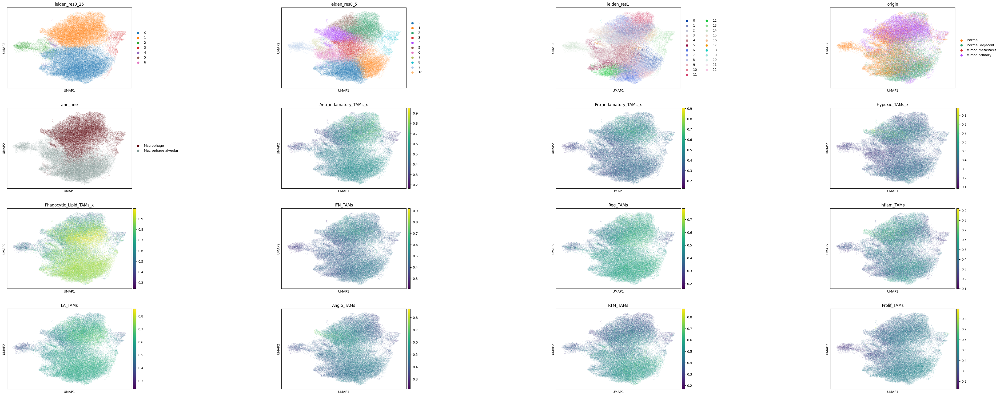

In [109]:
sc.pl.umap(adata_filtered, color=[ "leiden_res0_25", "leiden_res0_5", "leiden_res1", "origin", "ann_fine", 
                         "Anti_inflamatory_TAMs_x", "Pro_inflamatory_TAMs_x", "Hypoxic_TAMs_x", "Phagocytic_Lipid_TAMs_x", 
                        "IFN_TAMs",	"Reg_TAMs",	"Inflam_TAMs",	"LA_TAMs",	"Angio_TAMs",	"RTM_TAMs",	"Prolif_TAMs"], wspace=1)

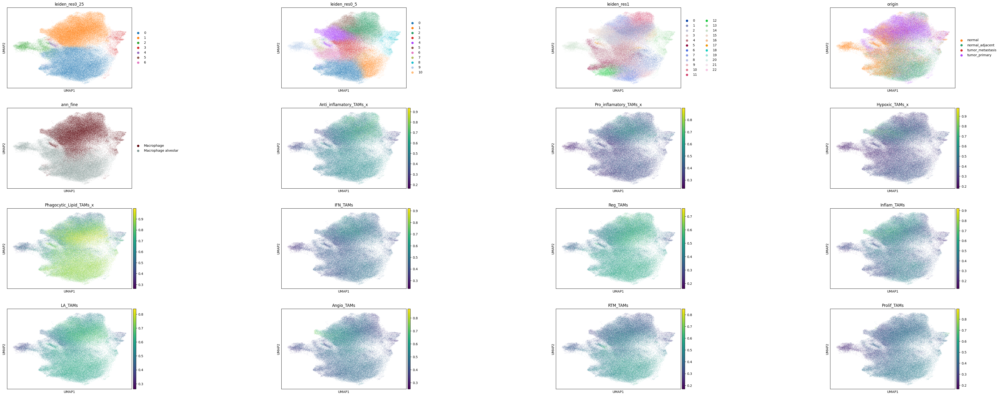

In [118]:
sc.pl.umap(adata_filtered_new, color=[ "leiden_res0_25", "leiden_res0_5", "leiden_res1", "origin", "ann_fine", 
                         "Anti_inflamatory_TAMs_x", "Pro_inflamatory_TAMs_x", "Hypoxic_TAMs_x", "Phagocytic_Lipid_TAMs_x", 
                        "IFN_TAMs",	"Reg_TAMs",	"Inflam_TAMs",	"LA_TAMs",	"Angio_TAMs",	"RTM_TAMs",	"Prolif_TAMs"], wspace=1)

In [74]:
import scanpy as sc
import pandas as pd
import random
import numpy as np
import matplotlib as plt
from pydeseq2.dds import DeseqDataSet
from pydeseq2.ds import DeseqStats

In [62]:
import scipy.sparse

In [63]:
import pandas as pd
import numpy as np

# Hücre isimleri (her gözlemin adı)
cell_names = ps_adata.obs_names

# Gen isimleri (her özelliğin adı, genler)
gene_names = ps_adata.var_names

# X matrisini (count verilerini) al ve numpy array'e çevir
counts_matrix = ps_adata.X.toarray() if scipy.sparse.issparse(ps_adata.X) else ps_adata.X

# Bunu pandas DataFrame olarak düzenleyelim
df_counts = pd.DataFrame(counts_matrix, index=cell_names, columns=gene_names)

# İlk birkaç satırı görelim
print(df_counts.head())


                                     ENSG00000121410  ENSG00000268895  \
Adams_Kaminski_2020_001CRTM_TAMs           10.684656              0.0   
Adams_Kaminski_2020_001CAngio_TAMs          0.000000              0.0   
Adams_Kaminski_2020_001CReg_TAMs            4.059573              0.0   
Adams_Kaminski_2020_001CLA_TAMs             1.036954              0.0   
Adams_Kaminski_2020_001CProlif_TAMs         0.881562              0.0   

                                     ENSG00000175899  ENSG00000245105  \
Adams_Kaminski_2020_001CRTM_TAMs           18.892044         0.000000   
Adams_Kaminski_2020_001CAngio_TAMs          0.000000         0.000000   
Adams_Kaminski_2020_001CReg_TAMs           15.684467         0.422638   
Adams_Kaminski_2020_001CLA_TAMs             6.067989         0.000000   
Adams_Kaminski_2020_001CProlif_TAMs         0.000000         0.000000   

                                     ENSG00000166535  ENSG00000128274  \
Adams_Kaminski_2020_001CRTM_TAMs            3.897

In [64]:
counts_df = pd.DataFrame(counts_matrix, index=cell_names, columns=gene_names)

metadata = pd.DataFrame(ps_adata.obs)

print(counts_df)
print(metadata)

                                     ENSG00000121410  ENSG00000268895  \
Adams_Kaminski_2020_001CRTM_TAMs           10.684656         0.000000   
Adams_Kaminski_2020_001CAngio_TAMs          0.000000         0.000000   
Adams_Kaminski_2020_001CReg_TAMs            4.059573         0.000000   
Adams_Kaminski_2020_001CLA_TAMs             1.036954         0.000000   
Adams_Kaminski_2020_001CProlif_TAMs         0.881562         0.000000   
...                                              ...              ...   
Leader_Merad_2021_414Inflam_TAMs            0.738252         0.000000   
Leader_Merad_2021_414Reg_TAMs               4.607873         0.897492   
Leader_Merad_2021_414IFN_TAMs               0.342176         0.000000   
Leader_Merad_2021_414Prolif_TAMs            0.278708         0.000000   
Leader_Merad_2021_414Int.Node.4             0.000000         0.000000   

                                     ENSG00000175899  ENSG00000245105  \
Adams_Kaminski_2020_001CRTM_TAMs           18.8920

In [66]:
la_tams_count_df = counts_df[counts_df.index.str.contains("LA_TAMs")]
la_tams_metadata = metadata[metadata.index.str.contains("LA_TAMs")]

print(la_tams_count_df)
print(la_tams_metadata)

                                   ENSG00000121410  ENSG00000268895  \
Adams_Kaminski_2020_001CLA_TAMs           1.036954         0.000000   
Adams_Kaminski_2020_002CLA_TAMs           4.823827         0.000000   
Adams_Kaminski_2020_003CLA_TAMs          15.907453         0.000000   
Adams_Kaminski_2020_022C-aLA_TAMs         4.063608         0.000000   
Adams_Kaminski_2020_022C-bLA_TAMs         3.444081         0.000000   
...                                            ...              ...   
Leader_Merad_2021_51LA_TAMs               1.633491         0.247733   
Leader_Merad_2021_398LA_TAMs              1.692097         0.000000   
Leader_Merad_2021_399LA_TAMs              0.481303         0.000000   
Leader_Merad_2021_413LA_TAMs              0.385264         0.488724   
Leader_Merad_2021_414LA_TAMs             11.553024         1.428158   

                                   ENSG00000175899  ENSG00000245105  \
Adams_Kaminski_2020_001CLA_TAMs           6.067989         0.000000   
Adams

In [92]:
# 'Name' sütununda 'Alice' ve 'David' olan satırları çıkarma
filtered_la_tams_metadata = la_tams_metadata[~la_tams_metadata['tumor_stage'].isin(['non-cancer'])]

print(filtered_la_tams_metadata)


                                Projection uicc_stage           origin  \
Chen_Zhang_2020_NSCLC-10LA_TAMs    LA_TAMs        III    tumor_primary   
Chen_Zhang_2020_NSCLC-3LA_TAMs     LA_TAMs          I    tumor_primary   
Chen_Zhang_2020_NSCLC-6LA_TAMs     LA_TAMs          I    tumor_primary   
Chen_Zhang_2020_NSCLC-8LA_TAMs     LA_TAMs        III    tumor_primary   
Chen_Zhang_2020_NSCLC-2LA_TAMs     LA_TAMs          I    tumor_primary   
...                                    ...        ...              ...   
Leader_Merad_2021_51LA_TAMs        LA_TAMs         II    tumor_primary   
Leader_Merad_2021_398LA_TAMs       LA_TAMs         II    tumor_primary   
Leader_Merad_2021_399LA_TAMs       LA_TAMs         II  normal_adjacent   
Leader_Merad_2021_413LA_TAMs       LA_TAMs         II  normal_adjacent   
Leader_Merad_2021_414LA_TAMs       LA_TAMs         II    tumor_primary   

                                                 donor_id  \
Chen_Zhang_2020_NSCLC-10LA_TAMs  Chen_Zhang_2020_N

In [93]:
# Sütunlarda kaç tane NaN var?
print(filtered_la_tams_metadata.isna().sum())

# Hangi sütunlarda NaN var?
print(filtered_la_tams_metadata.isna().any())

nan_rows = filtered_la_tams_metadata[filtered_la_tams_metadata.isna().any(axis=1)]

print(nan_rows)


Projection     0
uicc_stage     1
origin         0
donor_id       0
disease        0
tissue         0
study          0
tumor_stage    1
Subtype        0
dtype: int64
Projection     False
uicc_stage      True
origin         False
donor_id       False
disease        False
tissue         False
study          False
tumor_stage     True
Subtype        False
dtype: bool
                            Projection uicc_stage         origin  \
Leader_Merad_2021_36LA_TAMs    LA_TAMs        NaN  tumor_primary   

                                          donor_id              disease  \
Leader_Merad_2021_36LA_TAMs  Leader_Merad_2021_558  lung adenocarcinoma   

                            tissue              study tumor_stage  Subtype  
Leader_Merad_2021_36LA_TAMs   lung  Leader_Merad_2021         NaN  LA_TAMs  


In [84]:
print(filtered_la_tams_metadata.isna())

                                 Projection  uicc_stage  origin  donor_id  \
Chen_Zhang_2020_NSCLC-10LA_TAMs       False       False   False     False   
Chen_Zhang_2020_NSCLC-3LA_TAMs        False       False   False     False   
Chen_Zhang_2020_NSCLC-6LA_TAMs        False       False   False     False   
Chen_Zhang_2020_NSCLC-8LA_TAMs        False       False   False     False   
Chen_Zhang_2020_NSCLC-2LA_TAMs        False       False   False     False   
...                                     ...         ...     ...       ...   
Leader_Merad_2021_51LA_TAMs           False       False   False     False   
Leader_Merad_2021_398LA_TAMs          False       False   False     False   
Leader_Merad_2021_399LA_TAMs          False       False   False     False   
Leader_Merad_2021_413LA_TAMs          False       False   False     False   
Leader_Merad_2021_414LA_TAMs          False       False   False     False   

                                 disease  tissue  study  tumor_stage  Subty

In [71]:
filtered_la_tams_metadata.groupby("tumor_stage").size()

tumor_stage
advanced      110
early         198
non-cancer      0
dtype: int64

In [72]:
# df1'den, df2'deki index'lere göre subset alma
subset_la_tams_count_df = la_tams_count_df.loc[filtered_la_tams_metadata.index]

print(subset_la_tams_count_df)


                                 ENSG00000121410  ENSG00000268895  \
Chen_Zhang_2020_NSCLC-10LA_TAMs        21.292997         2.530213   
Chen_Zhang_2020_NSCLC-3LA_TAMs          0.000000         0.000000   
Chen_Zhang_2020_NSCLC-6LA_TAMs         92.404091        15.911485   
Chen_Zhang_2020_NSCLC-8LA_TAMs         98.476837        24.996098   
Chen_Zhang_2020_NSCLC-2LA_TAMs          4.851937         0.605307   
...                                          ...              ...   
Leader_Merad_2021_51LA_TAMs             1.633491         0.247733   
Leader_Merad_2021_398LA_TAMs            1.692097         0.000000   
Leader_Merad_2021_399LA_TAMs            0.481303         0.000000   
Leader_Merad_2021_413LA_TAMs            0.385264         0.488724   
Leader_Merad_2021_414LA_TAMs           11.553024         1.428158   

                                 ENSG00000175899  ENSG00000245105  \
Chen_Zhang_2020_NSCLC-10LA_TAMs       121.946274         0.554747   
Chen_Zhang_2020_NSCLC-3LA_TAMs   

In [77]:
print(subset_la_tams_count_df.dtypes)

ENSG00000121410    float32
ENSG00000268895    float32
ENSG00000175899    float32
ENSG00000245105    float32
ENSG00000166535    float32
                    ...   
ENSG00000070476    float32
ENSG00000203995    float32
ENSG00000162378    float32
ENSG00000159840    float32
ENSG00000074755    float32
Length: 17797, dtype: object


In [82]:
a = subset_la_tams_count_df * 10
a = round(a)
a = a.fillna(0)
print(a)

                                 ENSG00000121410  ENSG00000268895  \
Chen_Zhang_2020_NSCLC-10LA_TAMs            213.0             25.0   
Chen_Zhang_2020_NSCLC-3LA_TAMs               0.0              0.0   
Chen_Zhang_2020_NSCLC-6LA_TAMs             924.0            159.0   
Chen_Zhang_2020_NSCLC-8LA_TAMs             985.0            250.0   
Chen_Zhang_2020_NSCLC-2LA_TAMs              49.0              6.0   
...                                          ...              ...   
Leader_Merad_2021_51LA_TAMs                 16.0              2.0   
Leader_Merad_2021_398LA_TAMs                17.0              0.0   
Leader_Merad_2021_399LA_TAMs                 5.0              0.0   
Leader_Merad_2021_413LA_TAMs                 4.0              5.0   
Leader_Merad_2021_414LA_TAMs               116.0             14.0   

                                 ENSG00000175899  ENSG00000245105  \
Chen_Zhang_2020_NSCLC-10LA_TAMs           1219.0              6.0   
Chen_Zhang_2020_NSCLC-3LA_TAMs   

In [90]:
filtered_la_tams_metadata = filtered_la_tams_metadata.drop(index='Leader_Merad_2021_36LA_TAMs')

In [91]:
#inference = DefaultInference(n_cpus=8)
dds = DeseqDataSet(
    counts=a,
    metadata=filtered_la_tams_metadata,
    design_factors="tumor_stage",
    refit_cooks=True,
    #inference=,
    #n_cpus=8, # n_cpus can be specified here or in the inference object
)

ValueError: Observations annot. `obs` must have as many rows as `X` has rows (309), but has 308 rows.

In [97]:
sc.tl.leiden(adata_filtered, key_added="leiden_res0_25", resolution=0.25)

/mnt/ssd0/0524_descart_lung_atlas/descartes/lib/python3.11/site-packages/scanpy/tools/_leiden.py:199: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_added] = pd.Categorical(


In [ ]:
sc.tl.leiden(adata_filtered, key_added="leiden_res0_5", resolution=0.5)

In [ ]:
sc.tl.leiden(adata_filtered, key_added="leiden_res1", resolution=1.0)

In [ ]:
#Create a pseudo-bulk of LuCa-extended.

ps_adata_luca = make_pseudobulk(adata, sample_colname = 'sample', cell_type_colname = 'cell_type', metacols= ['donor_id', 'disease', 'tissue', 'study', 'sex', 'age', 'uicc_stage', 'tumor_stage'])

In [ ]:
pd.crosstab(ps_adata_luca.obs['study'], ps_adata_luca.obs['disease'])

In [ ]:
ps_adata_luca.obs

In [ ]:
#LuCa pb matrix
pd.DataFrame(ps_adata_luca.X, columns = ps_adata_luca.var_names)

In [ ]:
with open('/home/sharedFolder/int_fresh_start/Homo_sapiens.GRCh38.104.gtf') as f:
    gtf = list(f)

#prep the gtf file
gtf = [x for x in gtf if not x.startswith('#')]
gtf = [x for x in gtf if 'gene_id "' in x and 'gene_name "' in x]
gtf = list(map(lambda x: (x.split('gene_id "')[1].split('"')[0], x.split('gene_name "')[1].split('"')[0]), gtf))

In [ ]:
#row_names = de.index.tolist()
#row_names
#add rownames as a new column 
#de['gene_symbols'] = row_names
#gtf=dict(gtf)
#de['gene_name'] = de['gene_symbols'].map(gtf)

In [ ]:
marker_genes_dict_sym_sub = ["F3_ENSG00000117525", 'CLDN7', 'MUC4', "CEACAM5","GPR87","LY6K","LY6D","DSG2","SLC39A4","SERINC2","MUC21","TSPAN6","CEACAM6","ITGB4","DSG3","ITGA2","MUC1","GPRC5A","PRSS8","ITGB6","TSPAN1","CRB3","CLDN10","MPZL2","PROM2","CLDN1","CLDN3","TACSTD2","SLC6A14","CDH1","ERBB3","MSLN","SCNN1A","SDC1","LYPD3"]
sc.pl.tracksplot(adata, marker_genes_dict_sym_sub, "cell_type", dendrogram=True, gene_symbols = 'feature_name')